### NanoString panel expression in Pan Fetal Immune dataset

Set-up

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os,sys
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse
import anndata
import scvelo as scv

In [3]:
import cellrank as cr

In [4]:
# figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/PAGA_graphs/"
# if os.path.exists(figdir):
#     sc.settings.figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/PAGA_graphs/"
# else:
#     os.mkdir(figdir)
#     sc.settings.figdir = "/home/jovyan/mount/gdrive/Pan_fetal/Updates_and_presentations/figures/PAGA_graphs/"
    

In [5]:
## Directory to save intermediate outputs
writedir = "/nfs/team205/ed6/data/Fetal_immune/PAGA_FA_outs/"
if not os.path.exists(writedir):
    os.mkdir(writedir)    

In [6]:
## import utils
cwd = '../utils/'
sys.path.append(cwd)

import genes
import panfetal_utils

# import ti_utils

In [7]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [8]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

Activate the anndata2ri conversion between SingleCellExperiment and AnnData

In [9]:
anndata2ri.activate()

In [10]:
%load_ext rpy2.ipython

In [11]:
%%R
library(tidyverse)

### Load list of markers

In [12]:
gene_panel = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/SMI_1000plex_RNA_Panel_gene content.csv")

In [13]:
genes = gene_panel["HUGO Symbol"].values

### Load all annotations 

(stroma and ery are preliminary)

In [9]:
annos = [pd.read_csv("../manual_annotation/" + x, index_col=0) for x in os.listdir("../manual_annotation/") if "stroma" not in x]

annos = [x[["anno_lvl_2"]] if 'anno_lvl_2' in x.columns else x[["anno_lvl_1"]] for x in annos]

for anno in annos:
    anno.columns = ["anno_lvl_1"]

In [10]:
full_annos = pd.concat([x[["anno_lvl_2"]] if 'anno_lvl_2' in x.columns else x[["anno_lvl_1"]] for x in annos])
full_annos = full_annos[~full_annos.index.duplicated()]
# full_annos.drop_duplicates()

In [11]:
## Match stroma preliminary annotation
stroma_adata = sc.read_h5ad('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.batchCorrected_20210118.STROMA.batchCorrected.h5ad', backed="r")

stroma_anno = [pd.read_csv("../manual_annotation/" + x, index_col=0) for x in os.listdir("../manual_annotation/") if "stroma" in x][0]

stroma_anno["leiden_150"]  = stroma_anno.index

stroma_adata.obs["anno_lvl_1"] = stroma_anno.loc[stroma_adata.obs["leiden_150"].astype('int')]["anno_lvl_2"].values

In [12]:
full_annos = pd.concat([full_annos, stroma_adata.obs[["anno_lvl_1"]]])
full_annos = full_annos[~full_annos.index.duplicated()]

In [17]:
full_annos["anno_lvl_1_uniformed"] = [" ".join(x.upper().split("_")).split("CELL")[0] for x in full_annos["anno_lvl_1"].astype("str")]

In [19]:
full_annos.to_csv("/nfs/team205/ed6/data/Fetal_immune/tmp/PFI_annotations_20210407.csv")

In [19]:
del stroma_adata

### Load full dataset 

In [20]:
merged_raw = sc.read_h5ad('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.h5ad')

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Change barcodes for gut cells

In [21]:
def _rename_gut_cells(x):
    if "FCA" not in x:
        x = x.split("_")[8].split('-')[1] + "-1"  + "_" + "_".join(x.split("_")[3:6])
    else: 
        x = x.split("_")[7].split('-')[1] + "-1" + "_" + "_".join(x.split("_")[3:5]) 
    return(x)

obs_names = merged_raw.obs_names.values
gut_ixs = np.where(merged_raw.obs.organ=="GU")[0]
for i in gut_ixs:
    obs_names[i] = _rename_gut_cells(obs_names[i])

merged_raw.obs_names = obs_names

### Add obs with uniform labels and correct metadata

Made uniform in `notebooks/20210112_saveLabels.ipynb`

In [22]:
new_obs = pd.read_csv("/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.wGut.full_obs.csv", index_col=0)

In [23]:
merged_raw.obs = new_obs

### Visualize expression of genes in panel

Are there genes in the panel that are not measured by scRNA-seq?

In [24]:
genes[~pd.Series(genes).isin(merged_raw.var_names)]

array(['CYTOR', 'ENSG00000257764', 'ENSG00000258017', 'ENSG00000264577',
       'ENSG00000269968', 'FYB1', 'H2AZ1', 'H4C3', 'LINC02446', 'SELENOP',
       'VEGFD', 'VSIR'], dtype=object)

Which are the most highly expressed genes?

In [25]:
merged_raw.var_names_make_unique()

In [26]:
sdata = merged_raw[:, merged_raw.var_names.isin(genes)]
sdata = sdata[sdata.obs_names.isin(full_annos.index)]
sdata.obs = pd.concat([sdata.obs, full_annos],1)

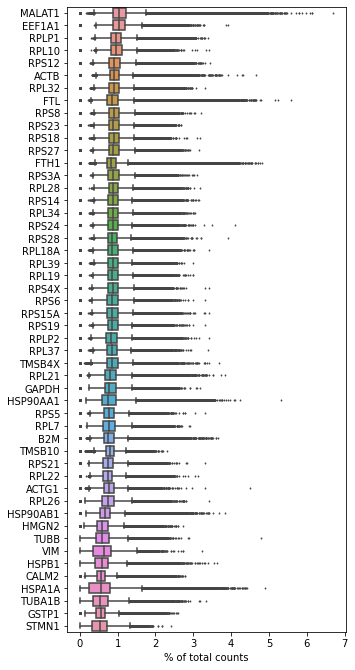

In [27]:
sc.pl.highest_expr_genes(sdata, n_top=50)

In [28]:
sc.pp.calculate_qc_metrics(sdata, inplace=True)

In [29]:
sdata

AnnData object with n_obs × n_vars = 893657 × 996
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'batch', 'bbk', 'uniform_label', 'uniform_label_expanded_merged', 'uniform_label_lvl0', 'Sample.lanes', 'Sort_id', 'age', 'method', 'sex', 'Processing_method', 'AnnatomicalPart', 'anno_lvl_1', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'GeneName', 'GeneID', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [68]:
sdata.obs["anno_lvl_1_uniformed"] = [" ".join(x.upper().split("_")).split("CELL")[0] for x in sdata.obs["anno_lvl_1"]]

In how many cells are the panel genes expressed?

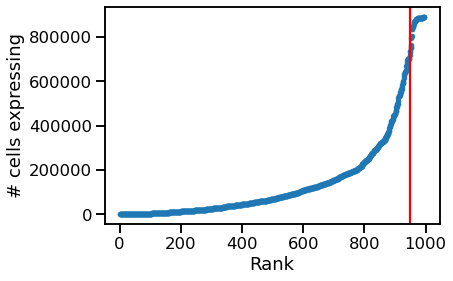

In [30]:
sns.set_context("talk")
plt.plot(sdata.var.n_cells_by_counts.rank(), sdata.var.n_cells_by_counts, '.');
plt.xlabel("Rank");
plt.ylabel("# cells expressing");
plt.axvline(x=950, color="r");

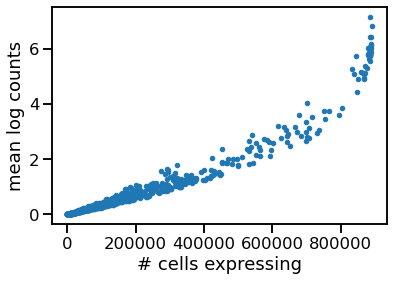

In [31]:
plt.plot(sdata.var.n_cells_by_counts, sdata.var.mean_counts, '.');
plt.ylabel("mean log counts");
plt.xlabel("# cells expressing");

#### Plot highly expressed genes

In [70]:
high_x_genes = sdata.var.sort_values('n_cells_by_counts', ascending=False)[0:50].index

... storing 'anno_lvl_1_uniformed' as categorical


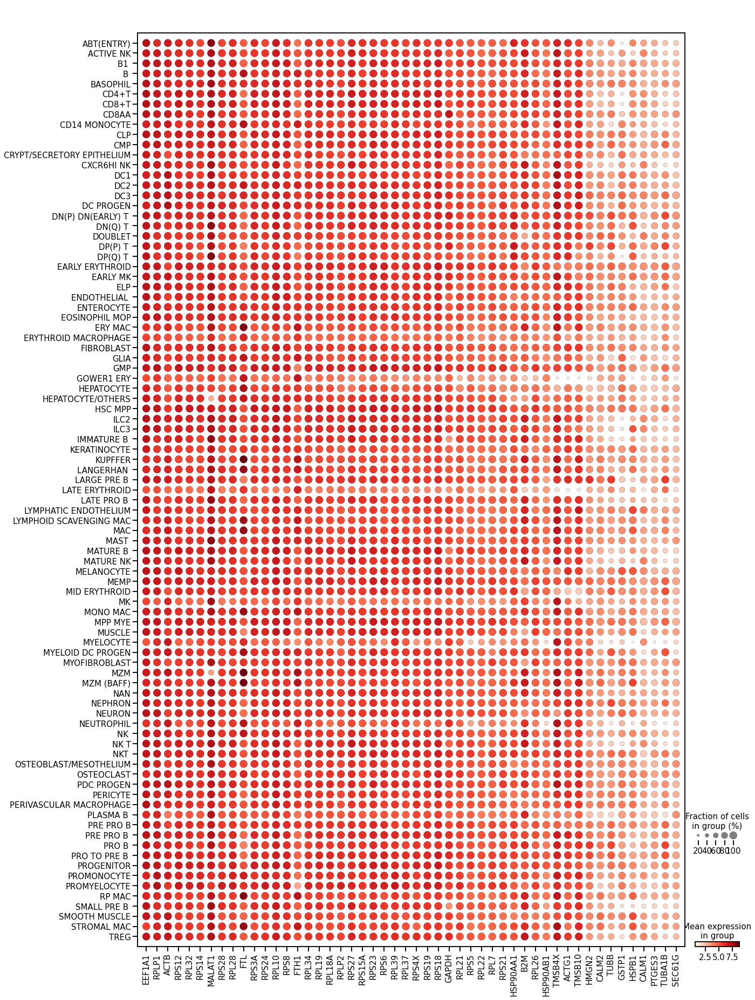

In [71]:
sc.pl.dotplot(sdata, high_x_genes, groupby="anno_lvl_1_uniformed")

#### Plot lowly expressed genes

In [408]:
low_x_genes = sdata.var[sdata.var['n_cells_by_counts'] < 1000].sort_values('n_cells_by_counts', ascending=True)[0:50].index

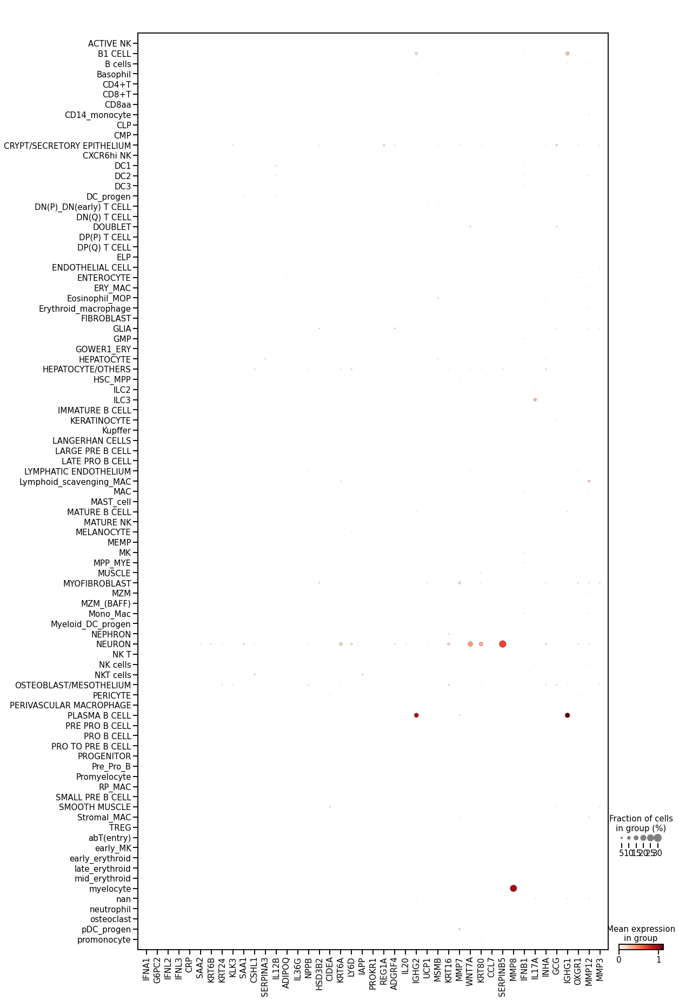

In [411]:
sc.pl.dotplot(sdata, low_x_genes, groupby="anno_lvl_1", save="lowExpr.png")

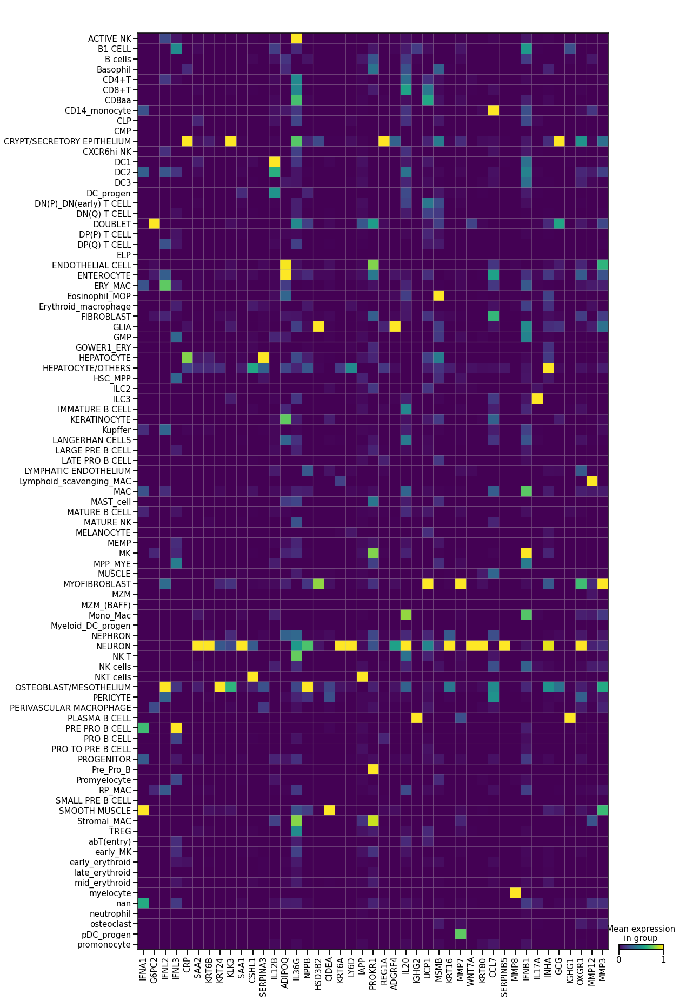

In [412]:
sc.pl.matrixplot(sdata, low_x_genes, groupby="anno_lvl_1", standard_scale='var')

### Plot genes by class


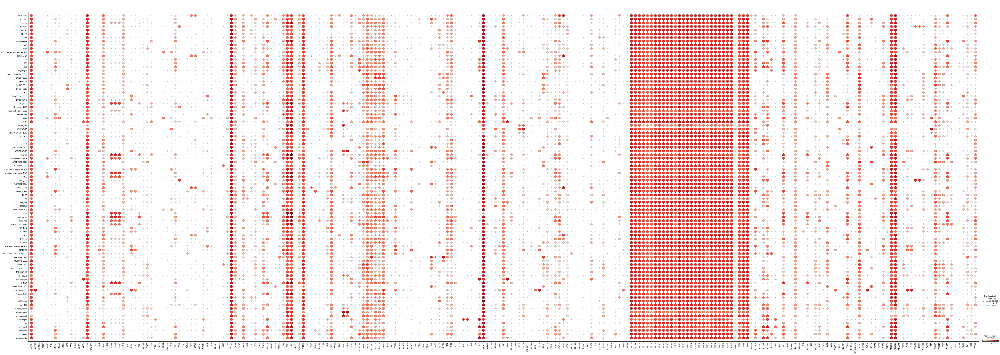

In [169]:
celltype_genes = gene_panel[gene_panel["Cell Type"]=="+"]["HUGO Symbol"]
celltype_genes = celltype_genes[celltype_genes.isin(sdata.var_names)]
sc.pl.dotplot(sdata, celltype_genes, groupby="anno_lvl_1")

In [171]:
sig_genes = gene_panel[gene_panel["Receptors & Ligands"]=="+"]["HUGO Symbol"]
sig_genes = sig_genes[sig_genes.isin(sdata.var_names)]

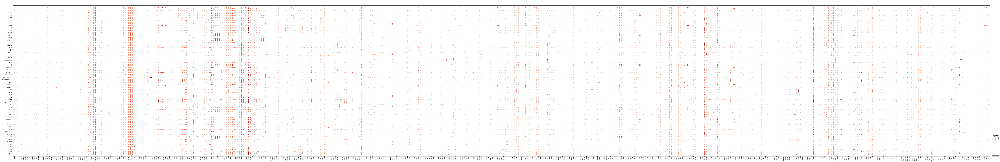

In [181]:
sc.pl.dotplot(sdata, sig_genes, groupby="anno_lvl_1")

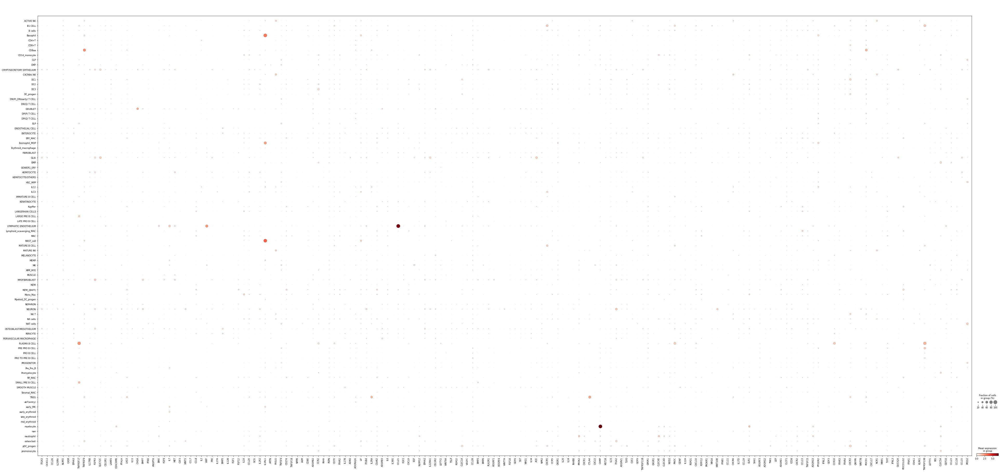

In [206]:
sdata.var["signalling"] = sdata.var_names.isin(sig_genes)
sig_genes_low = sdata.var_names[(sdata.var['signalling']) & (sdata.var['n_cells_by_counts'] < 20000)]
sc.pl.dotplot(sdata, sig_genes_low, groupby="anno_lvl_1")

### Cell stats
How many of the genes in the panel are expressed in each cell?

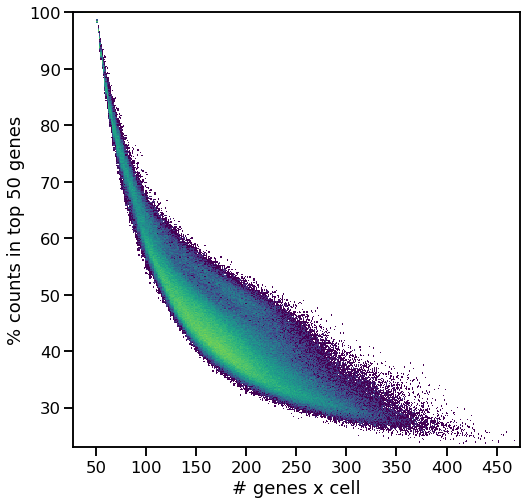

In [415]:
import matplotlib
plt.rcParams["figure.figsize"] = [8,8]
plt.hist2d(sdata.obs["n_genes_by_counts"], sdata.obs["pct_counts_in_top_50_genes"], norm=matplotlib.colors.LogNorm(), bins=1000);
plt.xlabel("# genes x cell");
plt.ylabel("% counts in top 50 genes");

In [419]:
sdata.obs["organ"] = ["TH" if 'pharyn' in x else x for x in sdata.obs["organ"] ]

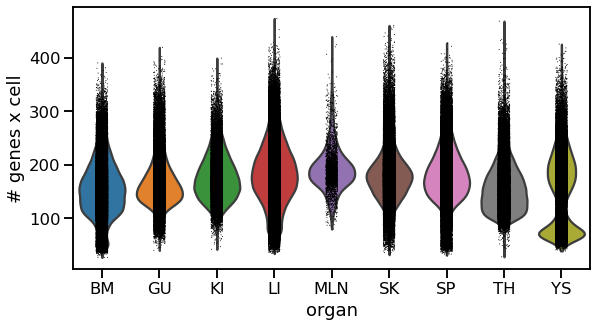

In [423]:
plt.rcParams["figure.figsize"] = [8,5]
sc.pl.violin(sdata, ["n_genes_by_counts"], groupby="organ", ylabel="# genes x cell");

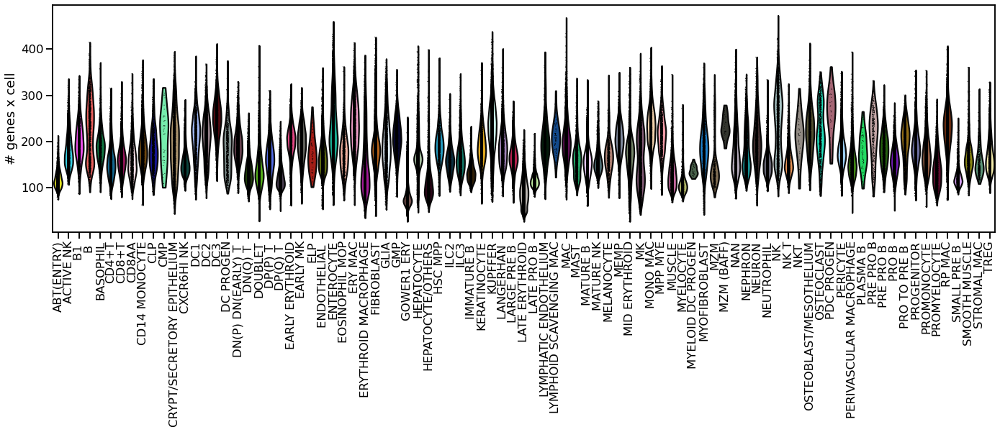

In [73]:
plt.rcParams["figure.figsize"] = [18,6]
sc.pl.violin(sdata, ["n_genes_by_counts"], groupby="anno_lvl_1_uniformed", rotation=90,  ylabel="# genes x cell");
# plt.ylabel("# genes x cell");

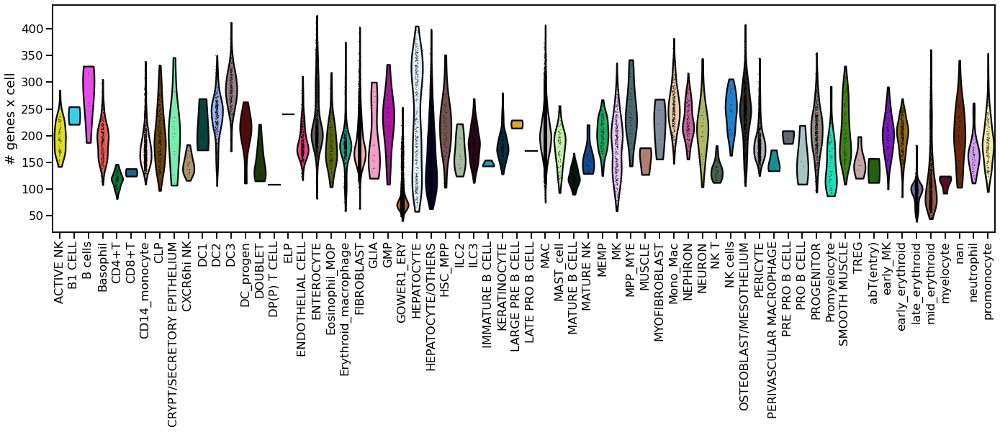

In [425]:
# sc.pl.violin(sdata, ["n_genes_by_counts"], groupby="organ", ylabel="# genes x cell");
plt.rcParams["figure.figsize"] = [18,6]
sc.pl.violin(sdata[sdata.obs.organ=="YS"], ["n_genes_by_counts"], groupby="anno_lvl_1", rotation=90,  ylabel="# genes x cell");

### PCA with panel of marker genes

In [30]:
sdata_pp = sdata.copy()
sc.pp.scale(sdata_pp,max_value=10)

Run ridge regression to exclude technical effects

In [31]:
import time
## Ridge regression
start=time.time()
batch_keys=['method','donor']
conf_key = ['uniform_label_lvl0']

panfetal_utils.ridge_regression(sdata_pp, batch_key=batch_keys,confounder_key=conf_key)
v2_time = time.time() - start
print("Ridge regression runtime: ", str(v2_time))

sdata_pp.X = sdata_pp.layers['X_remain']
del sdata_pp.layers['X_remain']
del sdata_pp.layers['X_explained']

Ridge regression runtime:  34.53422141075134


In [32]:
sc.pp.pca(sdata_pp, use_highly_variable=False)

... storing 'Sample' as categorical
... storing 'donor' as categorical
... storing 'organ' as categorical
... storing 'file' as categorical
... storing 'predicted_doublets' as categorical
... storing 'name' as categorical
... storing 'batch' as categorical
... storing 'bbk' as categorical
... storing 'uniform_label' as categorical
... storing 'uniform_label_expanded_merged' as categorical
... storing 'uniform_label_lvl0' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sort_id' as categorical
... storing 'method' as categorical
... storing 'sex' as categorical
... storing 'Processing_method' as categorical
... storing 'AnnatomicalPart' as categorical
... storing 'anno_lvl_1' as categorical


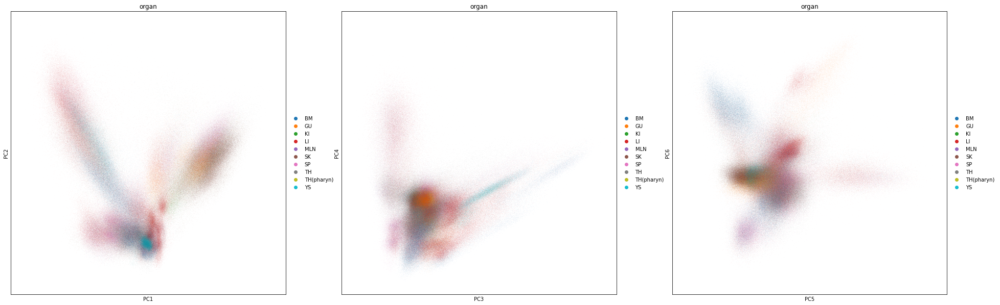

In [33]:
plt.rcParams["figure.figsize"] = [10,10]
sc.pl.pca(sdata_pp, color=["organ"], components=["1,2", '3,4', '5,6'])

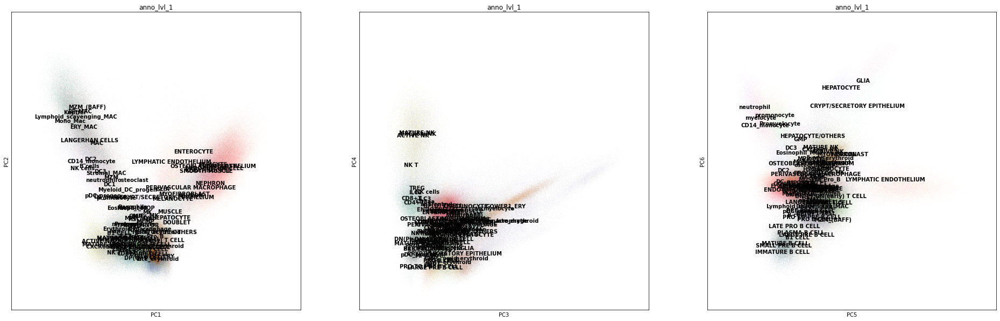

In [34]:
sc.pl.pca(sdata_pp, color=["anno_lvl_1"], components=["1,2", '3,4', '5,6'], legend_loc="on data")

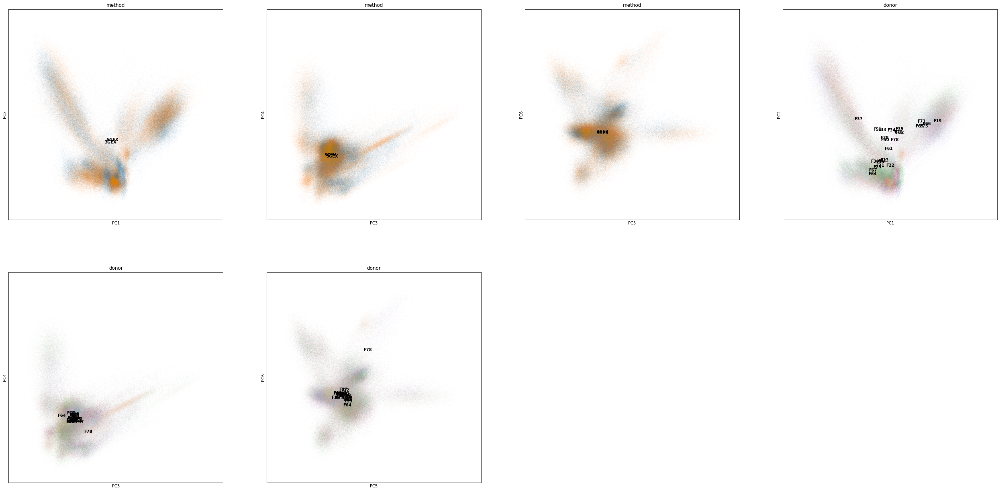

In [35]:
sc.pl.pca(sdata_pp, color=["method", "donor"], components=["1,2", '3,4', '5,6'], legend_loc="on data")

Does variance in the panel genes distinguish celltypes?

In [74]:
sdata_pp.obs['anno_lvl_1_uniformed'] = sdata.obs['anno_lvl_1_uniformed'].copy()

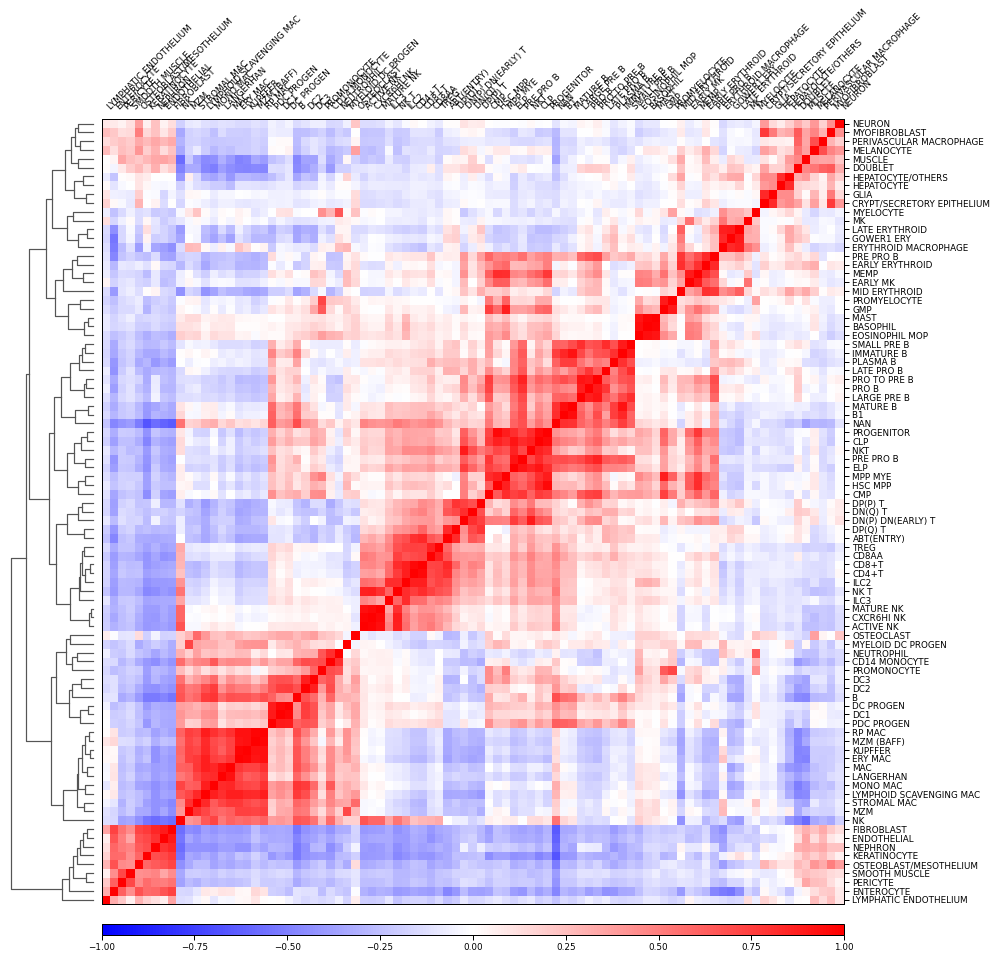

In [78]:
sns.set_context("paper")
ax = sc.pl.correlation_matrix(sdata_pp, 'anno_lvl_1_uniformed', figsize=(15,15))

In [45]:
# ordered_cts = sdata_pp.uns['dendrogram_anno_lvl_1']['categories_ordered']

# B_cts = [x for x in ordered_cts if "B CELL" in x or "B1" in x ]

In [79]:
sc.tl.rank_genes_groups(sdata, groupby="anno_lvl_1_uniformed", n_genes=5)

In [56]:
# sns.set_context("talk")
# plt.rcParams['figure.figsize'] = [5,5]
# sc.pl.rank_genes_groups(sdata, groupby="anno_lvl_1", n_genes=5)

In [57]:
sdata.obsm["X_pca"] = sdata_pp.obsm["X_pca"].copy()

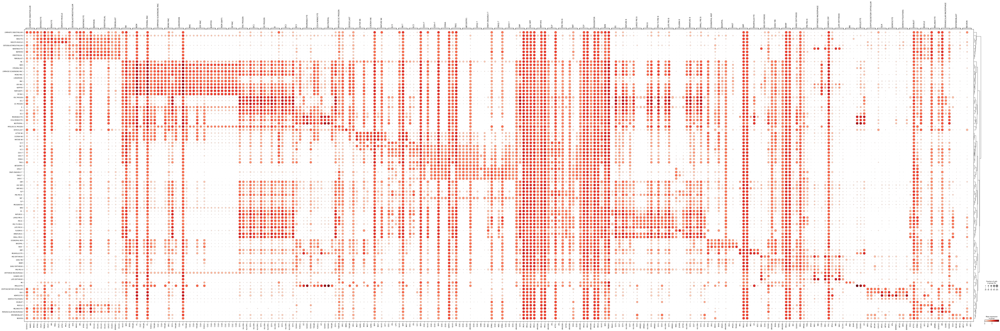

In [81]:
sc.pl.rank_genes_groups_dotplot(sdata, groupby="anno_lvl_1_uniformed", n_genes=3, save="markers_nanostring_panel.png")

### Check overlap with organ-specific genes

In [235]:
de_res = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/significant_genes/LMM_Natsuhiko_results/de_lymphoid_ltsr0.9.csv")
de_res.columns = [x.split(" ")[0] for x in de_res.columns]

How many genes in panel are among DE genes?

In [244]:
sdata.var_names.isin(de_res.gene).sum()

570

In [257]:
df = de_res[de_res.gene.isin(sdata.var_names)]

In [304]:
panel_genes = sdata.var_names

`summarise()` has grouped output by 'celltype'. You can override using the `.groups` argument.


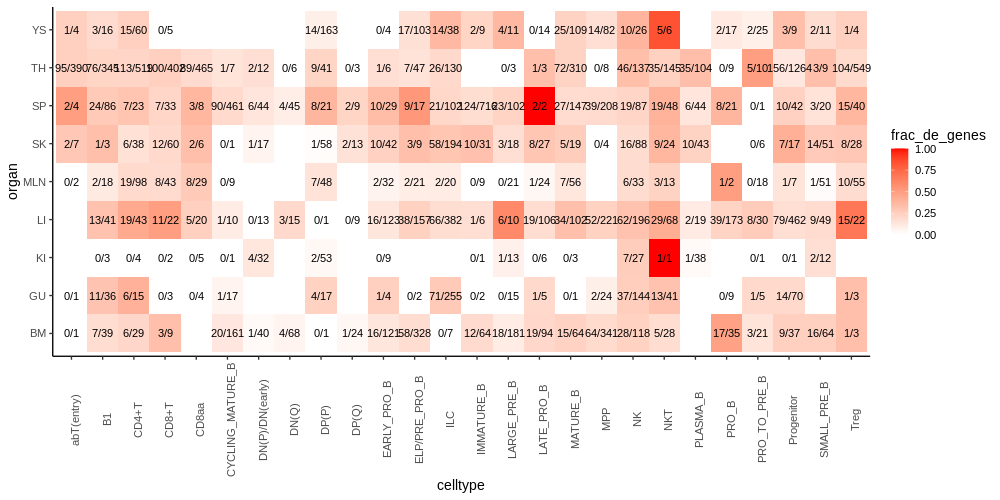

In [315]:
%%R -i de_res -i panel_genes -w 1000 -h 500

de_res %>%
 select(gene, organ, celltype, logFoldChange) %>%
    mutate(in_panel=ifelse(gene %in% panel_genes, TRUE, FALSE)) %>%
    group_by(celltype, organ) %>%
    summarise(n_de_genes=n(), n_de_genes_in_panel=sum(in_panel)) %>%
    mutate(frac_de_genes = n_de_genes_in_panel/n_de_genes) %>%
    ggplot(aes(celltype, organ)) +
    geom_tile(aes(fill=frac_de_genes)) +
    geom_text(aes(label=paste0(n_de_genes_in_panel, "/", n_de_genes))) +
    scale_fill_gradient(high="red", low="white") +
    theme_classic(base_size=14) +
    theme(axis.text.x=element_text(angle=90)) 
#     scale_fill_gradient2()
    # unique(df$organ)

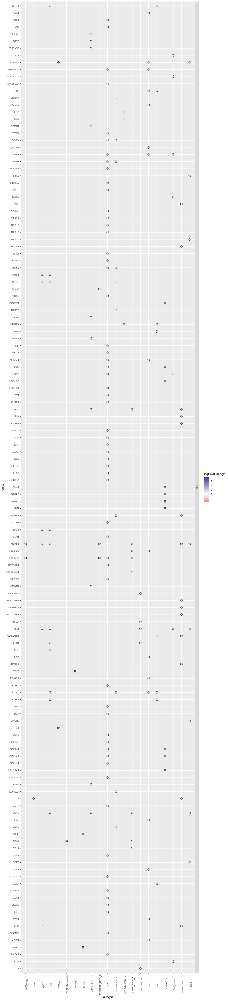

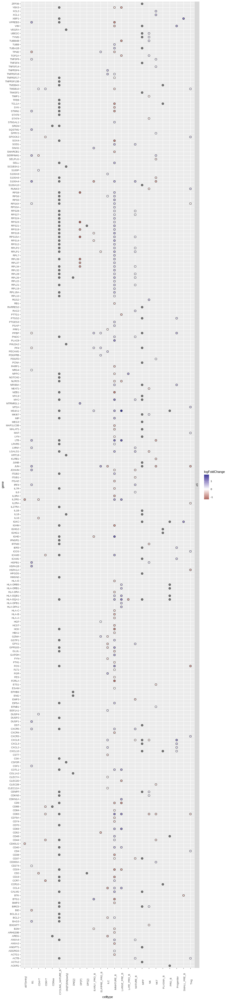

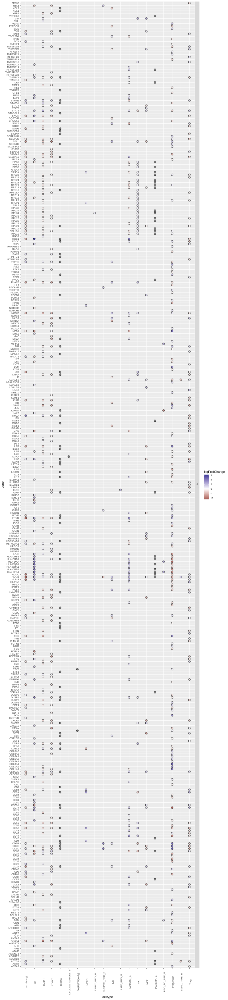

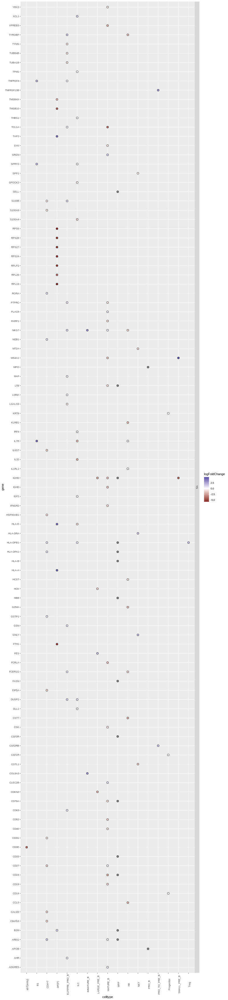

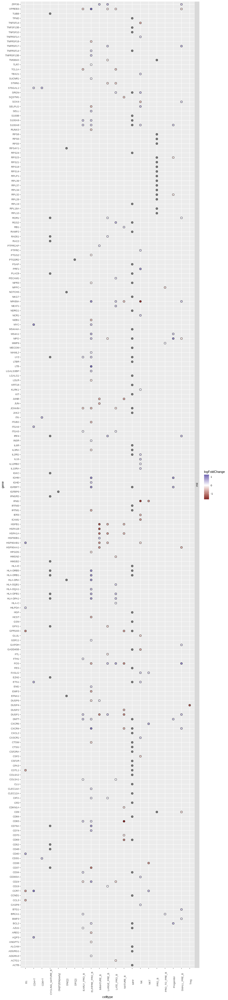

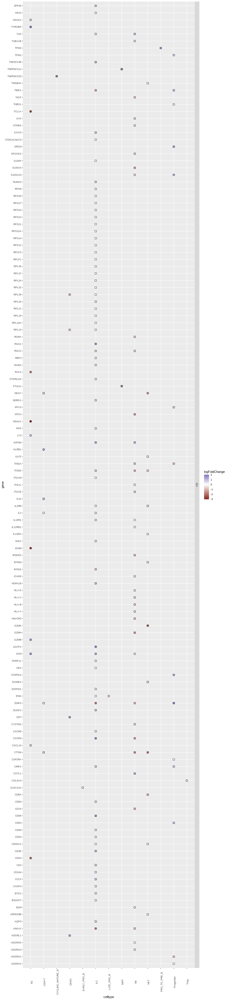

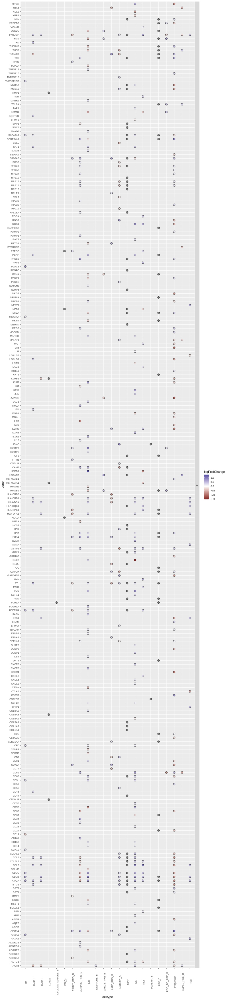

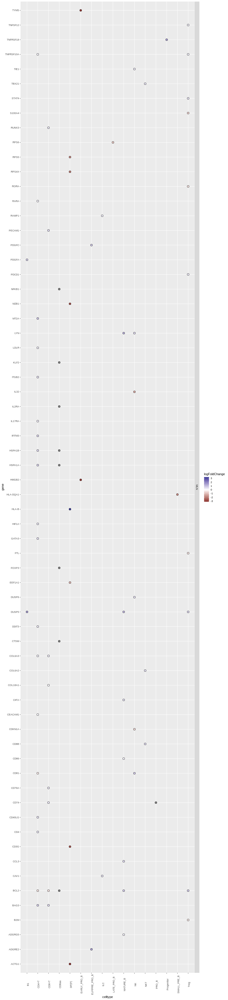

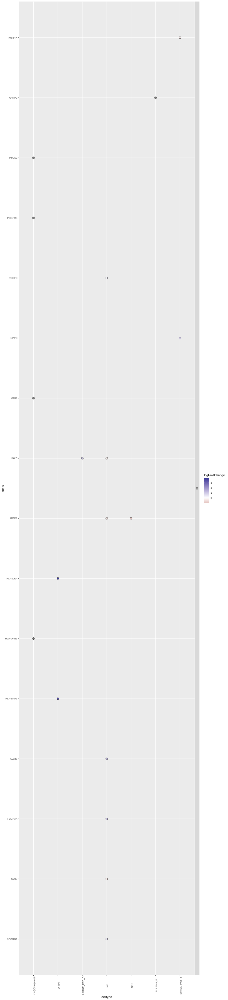

In [294]:
%%R -i df -w 800 -h 3500
for (org in unique(df$organ)){
    pl <- df %>%
 select(gene, organ, celltype, logFoldChange) %>%
    filter(organ==org) %>%
     ggplot(aes(celltype, gene, fill=logFoldChange)) +
    geom_point(size=3, shape=21) + 
    facet_grid(organ~., scales="free", space="free") +
    theme(axis.text.x=element_text(angle=90)) +
    scale_fill_gradient2()
    
    print(pl)
}
# unique(df$organ)

## Focus on gut cells

### PCA with panel of marker genes

In [332]:
sdata_gut = sdata.copy()
sdata_gut = sdata_gut[sdata_gut.obs["organ"].isin(["GU", "MLN"])]

In [333]:
sc.pp.scale(sdata_gut, max_value=10)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Run ridge regression to exclude technical effects

In [334]:
import time
## Ridge regression
start=time.time()
batch_keys=['method','donor']
conf_key = ['uniform_label_lvl0']

panfetal_utils.ridge_regression(sdata_gut, batch_key=batch_keys,confounder_key=conf_key)
v2_time = time.time() - start
print("Ridge regression runtime: ", str(v2_time))

sdata_gut.X = sdata_gut.layers['X_remain']
del sdata_gut.layers['X_remain']
del sdata_gut.layers['X_explained']

Ridge regression runtime:  1.3258099555969238


In [335]:
sc.pp.pca(sdata_gut, use_highly_variable=False)

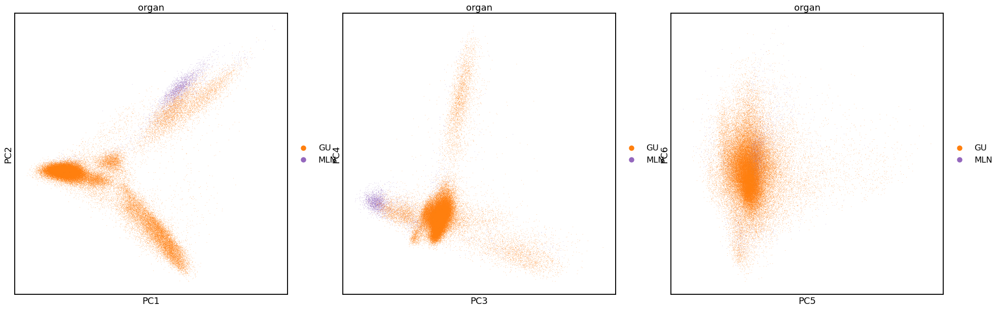

In [336]:
plt.rcParams["figure.figsize"] = [10,10]
sc.pl.pca(sdata_gut, color=["organ"], components=["1,2", '3,4', '5,6'])

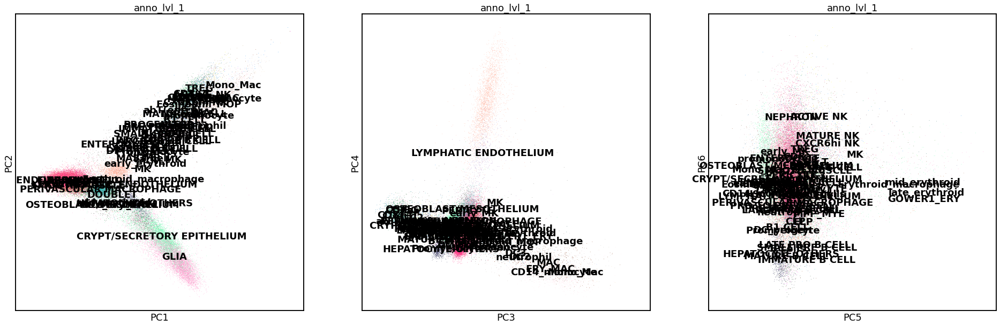

In [337]:
sc.pl.pca(sdata_gut, color=["anno_lvl_1"], components=["1,2", '3,4', '5,6'], legend_loc="on data")

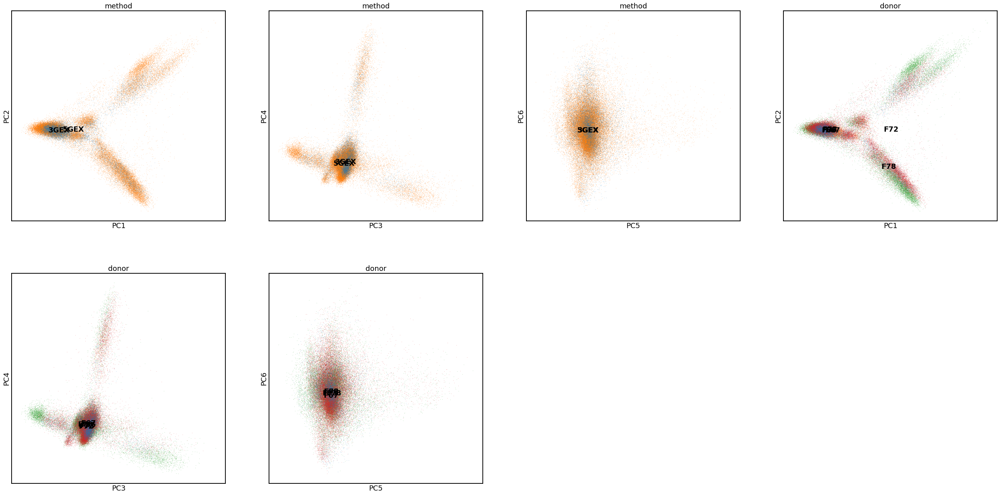

In [338]:
sc.pl.pca(sdata_gut, color=["method", "donor"], components=["1,2", '3,4', '5,6'], legend_loc="on data")

Does variance in the panel genes distinguish celltypes?

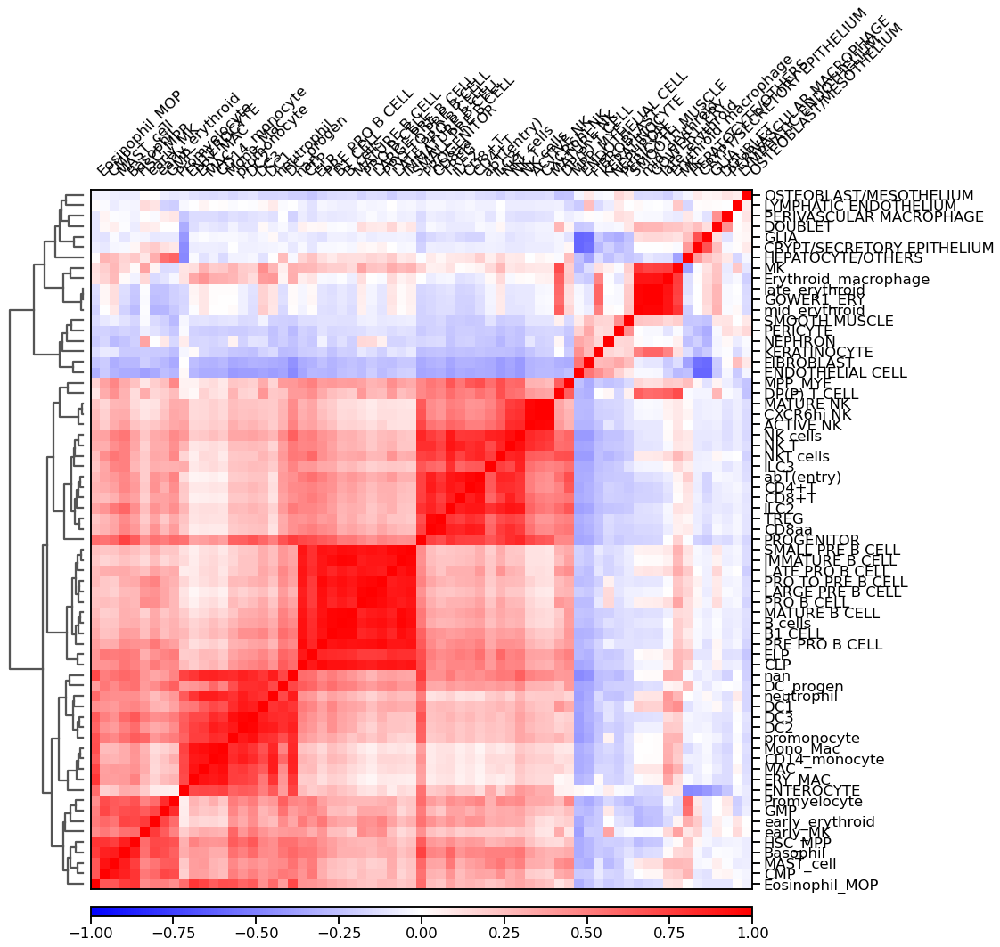

In [339]:
ax = sc.pl.correlation_matrix(sdata_gut, 'anno_lvl_1', figsize=(15,15))

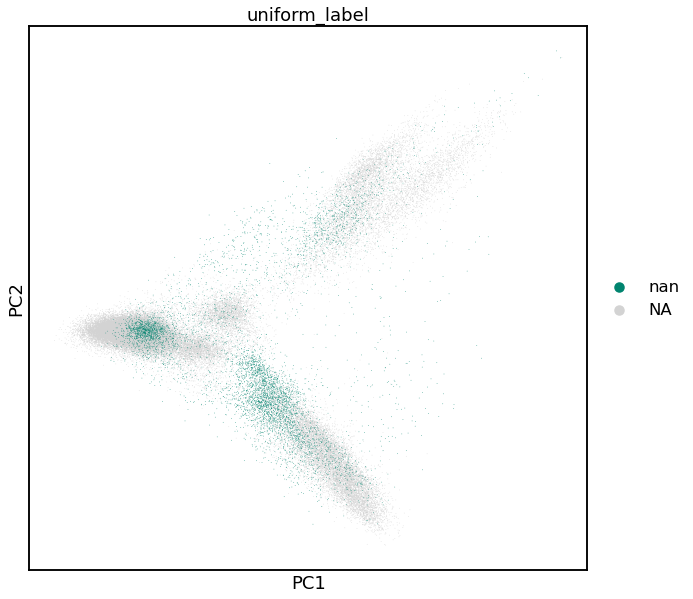

In [365]:
sc.pl.pca(sdata_gut, color="uniform_label", groups="nan")

In [368]:
sdata_gut_nonan = sdata_gut[sdata_gut.obs['uniform_label'] != "nan"]

In [370]:
sc.pp.pca(sdata_gut_nonan, use_highly_variable=False)

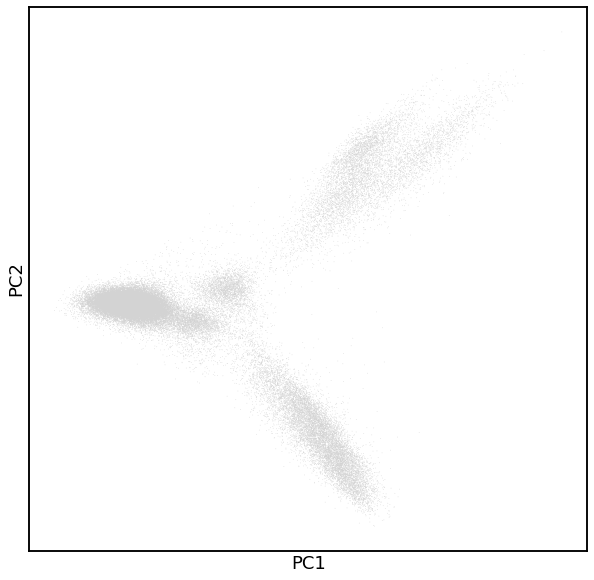

In [372]:
sc.pl.pca(sdata_gut_nonan)

In [380]:
sdata_gut_nonan.obs["uniform_label"] = sdata_gut_nonan.obs["uniform_label"].astype("str").astype("category")

In [385]:
sc.tl.dendrogram(sdata_gut_nonan, groupby="uniform_label")

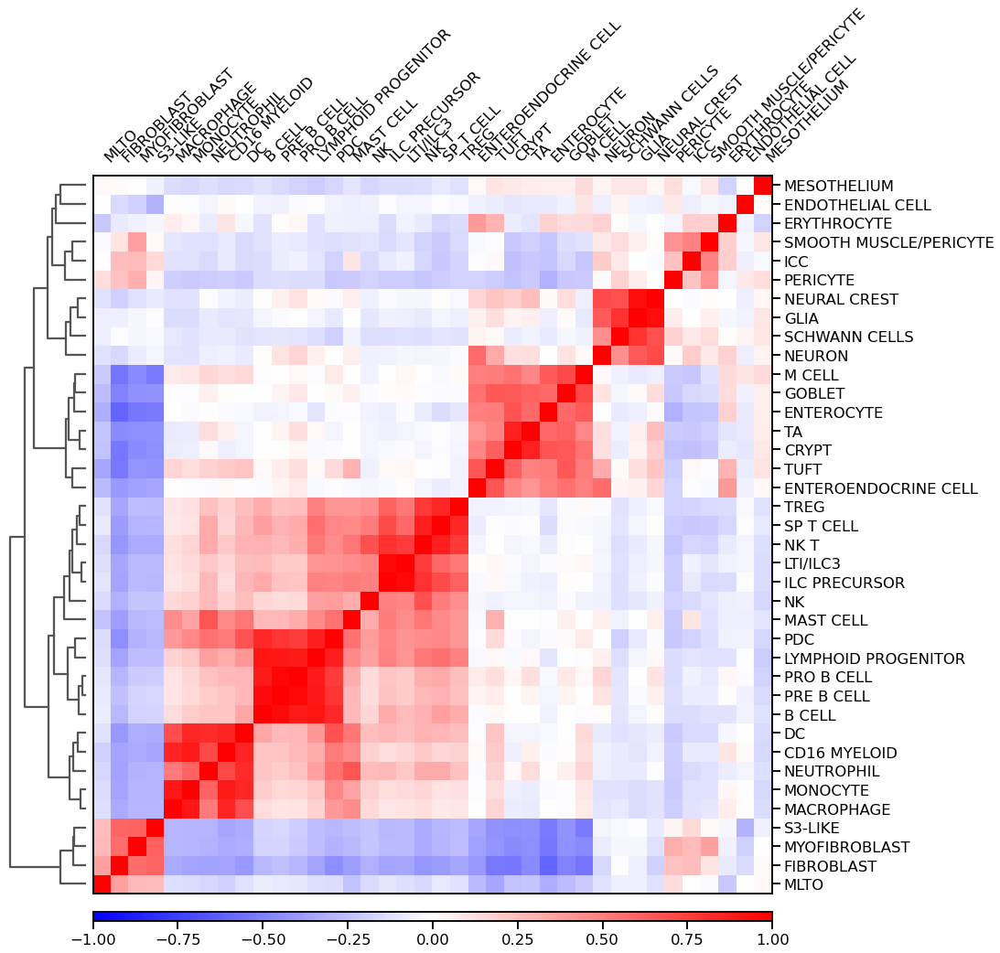

In [386]:
sc.pl.correlation_matrix(sdata_gut_nonan, 'uniform_label', figsize=(15,15))

## Focus on thymus cells

In [82]:
sdata_th = sdata.copy()
sdata_th = sdata_th[sdata_th.obs["organ"].isin(["TH"])]

In [83]:
sc.pp.scale(sdata_th, max_value=10)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Run ridge regression to exclude technical effects

In [84]:
import time
## Ridge regression
start=time.time()
batch_keys=['method','donor']
conf_key = ['uniform_label_lvl0']

panfetal_utils.ridge_regression(sdata_th, batch_key=batch_keys,confounder_key=conf_key)
v2_time = time.time() - start
print("Ridge regression runtime: ", str(v2_time))

In [85]:
sdata_th.X = sdata_th.layers['X_remain']
del sdata_th.layers['X_remain']
del sdata_th.layers['X_explained']

In [86]:
sc.pp.pca(sdata_th, use_highly_variable=False)

Does variance in the panel genes distinguish celltypes?

In [88]:
sc.tl.dendrogram(sdata_th, groupby="anno_lvl_1_uniformed")

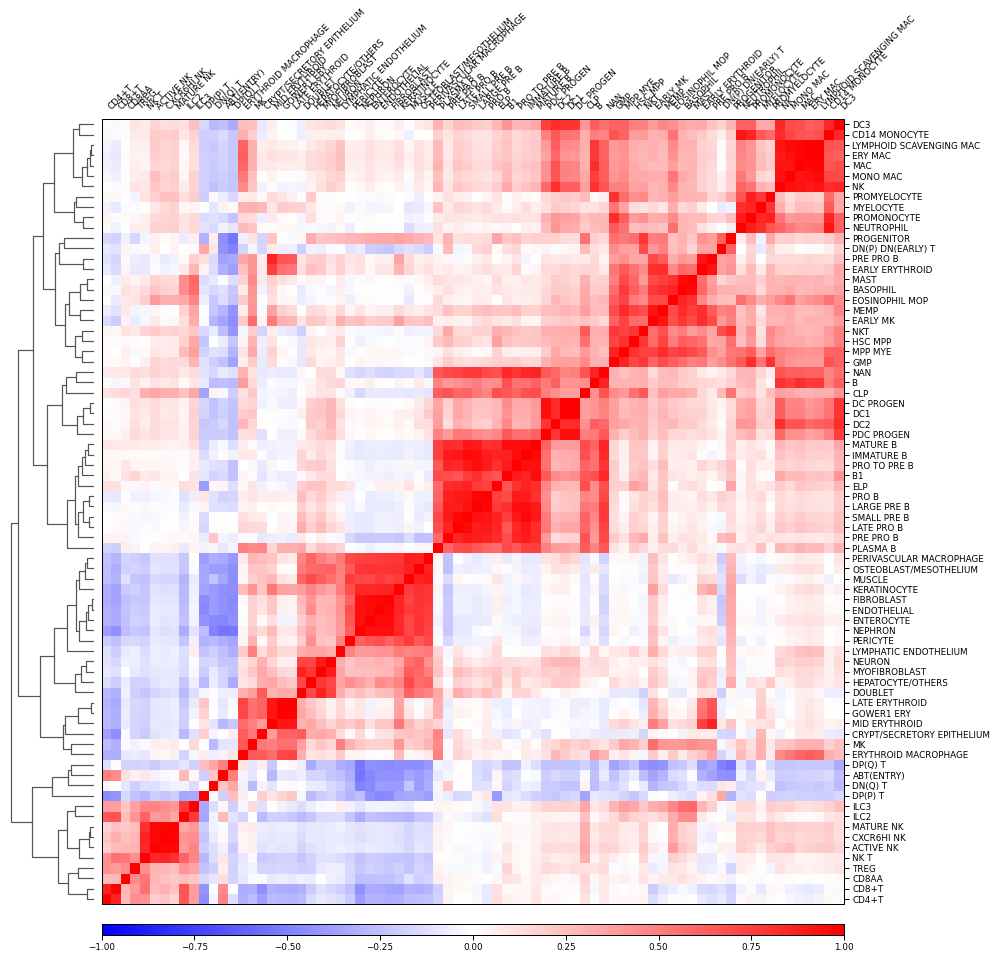

In [97]:
ax = sc.pl.correlation_matrix(sdata_th, 'anno_lvl_1_uniformed', figsize=(15,15), save="thymus.png")

## Focus on spleen cells

In [90]:
sdata_sp = sdata.copy()
sdata_sp = sdata_sp[sdata_sp.obs["organ"].isin(["SP"])]

In [91]:
sc.pp.scale(sdata_sp, max_value=10)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Run ridge regression to exclude technical effects

In [92]:
import time
## Ridge regression
start=time.time()
batch_keys=['method','donor']
conf_key = ['uniform_label_lvl0']

panfetal_utils.ridge_regression(sdata_sp, batch_key=batch_keys,confounder_key=conf_key)
v2_time = time.time() - start
print("Ridge regression runtime: ", str(v2_time))

Ridge regression runtime:  3.297300100326538


In [93]:
sdata_sp.X = sdata_sp.layers['X_remain']
del sdata_sp.layers['X_remain']
del sdata_sp.layers['X_explained']

In [94]:
sc.pp.pca(sdata_sp, use_highly_variable=False)

Does variance in the panel genes distinguish celltypes?

In [95]:
sc.tl.dendrogram(sdata_sp, groupby="anno_lvl_1_uniformed")

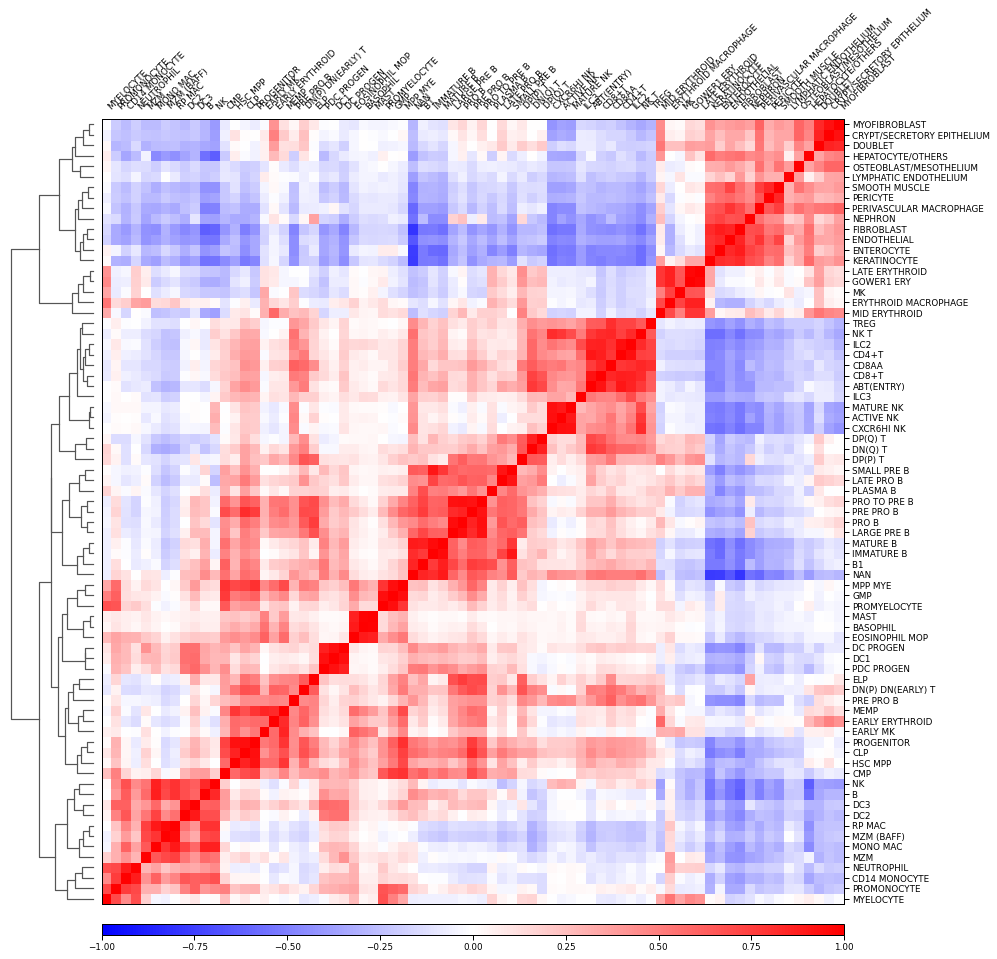

In [98]:
ax = sc.pl.correlation_matrix(sdata_sp, 'anno_lvl_1_uniformed', figsize=(15,15), save="spleen.png")

## Focus on liver cells

In [99]:
sdata_li = sdata.copy()
sdata_li = sdata_li[sdata_li.obs["organ"].isin(["LI"])]

In [100]:
sc.pp.scale(sdata_li, max_value=10)

/home/jovyan/my-conda-envs/emma_env/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Run ridge regression to exclude technical effects

In [101]:
import time
## Ridge regression
start=time.time()
batch_keys=['method','donor']
conf_key = ['uniform_label_lvl0']

panfetal_utils.ridge_regression(sdata_li, batch_key=batch_keys,confounder_key=conf_key)
v2_time = time.time() - start
print("Ridge regression runtime: ", str(v2_time))

Ridge regression runtime:  5.1342902183532715


In [102]:
sdata_li.X = sdata_li.layers['X_remain']
del sdata_li.layers['X_remain']
del sdata_li.layers['X_explained']

In [103]:
sc.pp.pca(sdata_li, use_highly_variable=False)

Does variance in the panel genes distinguish celltypes?

In [105]:
sc.tl.dendrogram(sdata_li, groupby="anno_lvl_1_uniformed")

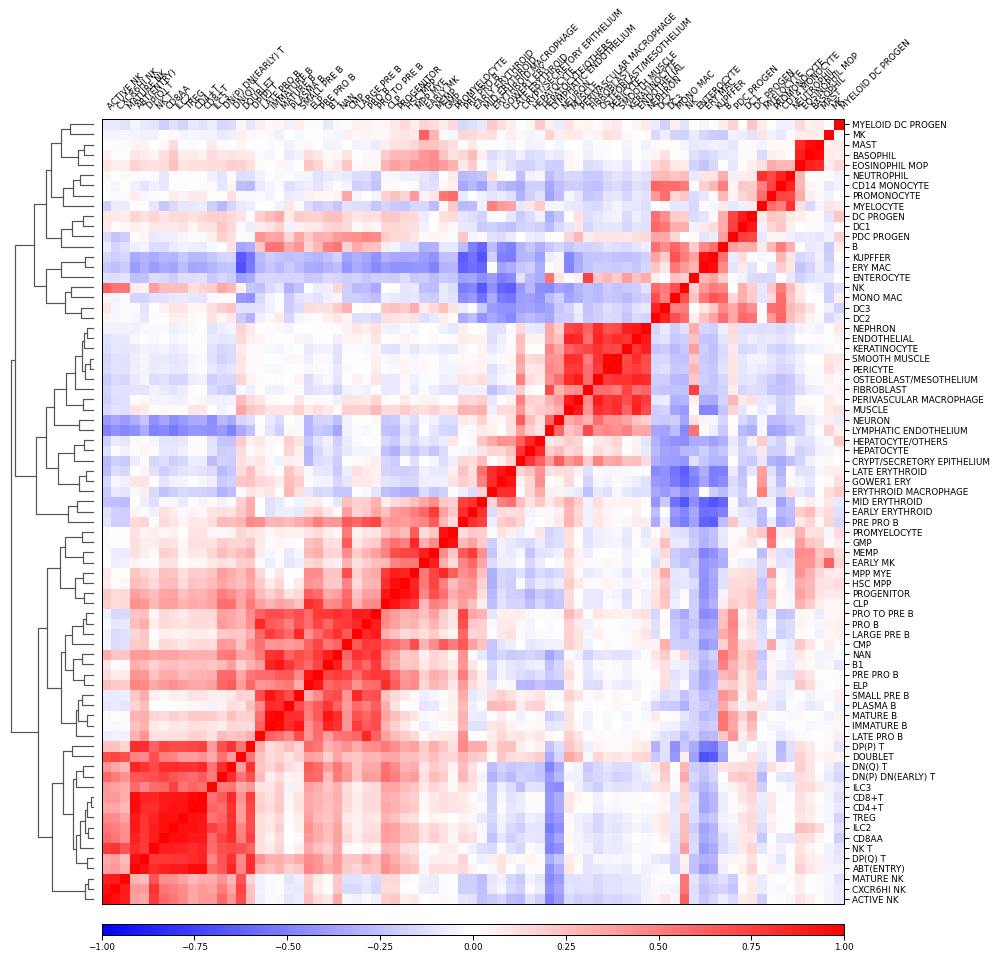

In [106]:
ax = sc.pl.correlation_matrix(sdata_li, 'anno_lvl_1_uniformed', figsize=(15,15), save="liver.png")

### Embedding on B cells

In [109]:
[x for x in sdata_pp.obs["anno_lvl_1_uniformed"].unique()]

['KUPFFER', 'ERYTHROID MACROPHAGE', 'NAN', 'CXCR6HI NK', 'ERY MAC', ..., 'MYELOID DC PROGEN', 'LANGERHAN ', 'MELANOCYTE', 'SMOOTH MUSCLE', 'GLIA']
Length: 89
Categories (89, object): ['KUPFFER', 'ERYTHROID MACROPHAGE', 'NAN', 'CXCR6HI NK', ..., 'LANGERHAN ', 'MELANOCYTE', 'SMOOTH MUSCLE', 'GLIA']